In [ ]:
!pip install bs4
!pip install imblearn
!pip install spacy
!pip install spacy_langdetect

In [ ]:
from bs4 import BeautifulSoup
import requests
import pandas as pd
import seaborn as sns

import nltk
from nltk.corpus import stopwords

nltk.download('stopwords')
nltk.download('punkt')

sns.set({})

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# 1. Web Scraping

In [ ]:
# Scraping from MyAnimeList
HEADERS = {
    "User-Agent": "Whatever"
}

RATING_NOT_RECOMMENDED = 0
RATING_MIXED = 1
RATING_RECOMMENDED = 2

def get_reviews(url: str, page_count: int = 5) -> pd.DataFrame:
    result = []

    for page in range(page_count):
        response = requests.get(url, headers=HEADERS)

        if response.status_code != 200:
          print(f"Error on page {page}. Error: {response.content.decode()}")
          break

        bs = BeautifulSoup(response.content.decode(), "html.parser")
        reviews = bs.select(".review-element.js-review-element")

        for review in reviews:
            date_element = review.select_one(".update_at")
            try:
              result.append({
                  "recommendation": review.select_one(".tag").get_text(),
                  "review_text": review.select_one(".text").get_text(),
              })
            except:
              print("Error on page", page)
              continue

        next_link = bs.select_one("a[data-ga-click-type='review-next']")
        
        if not next_link:
          print("Max reviews at page", page)
          break

        url = next_link['href']

    return pd.DataFrame(
        columns=['review_text', 'recommendation'],
        data=result
    )

In [ ]:
data = get_reviews("https://myanimelist.net/reviews.php?t=anime", 150)
data.head(30)

Error on page 119


,review_text,recommendation
0,\n\n\n\n\n\n I do not ever have...,Recommended
1,\n\n\n\n\n\n My shipfu is the b...,Recommended
2,\n\n\n\n\n\n Plot: 8.5\r\n- Exc...,Recommended
3,\n\n\n\n\n\n I really did like ...,Mixed Feelings
4,\n\n\n\n\n\n My review will be ...,Not Recommended
5,"\n\n\n\n\n\n Man, I was really ...",Not Recommended
6,\n\n\n\n\n\n This is one of the...,Recommended
7,\n\n\n\n\n\n A lot of aspects o...,Mixed Feelings
8,\n\n\n\n\n\n I'm just going to ...,Not Recommended
9,"\n\n\n\n\n\n Lookism, it's an a...",Not Recommended


In [ ]:
data.count()

review_text       7499
recommendation    7499
dtype: int64

In [ ]:
data.to_csv('review_data', index=False)

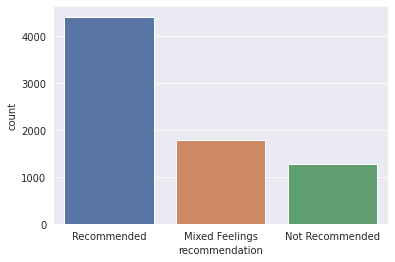

In [ ]:
sns.countplot(x=data['recommendation'])

In [ ]:
import spacy 
from spacy_langdetect import LanguageDetector
from spacy.language import Language

def get_lang_detector(nlp, name):
    return LanguageDetector()

nlp = spacy.load("en_core_web_sm")
Language.factory("language_detector", func=get_lang_detector)
nlp.add_pipe('language_detector', last=True)

/usr/local/lib/python3.8/dist-packages/torch/cuda/__init__.py:497: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


In [ ]:
for index, rows in data.iterrows():
    detect_language = nlp(rows.review_text)
    if detect_language._.language['language'] != 'en':
        data = data.drop([index])
        
data.head()

,review_text,recommendation
0,I do not ever have high hopes for Netflix adap...,Recommended
1,"My shipfu is the best shipfu. 'Not Hoteru, Hot...",Recommended
2,Plot: 8.5 - Excellent plot and problem progres...,Recommended
3,I really did like the first couple of episodes...,Mixed Feelings
4,My review will be short since there's barely a...,Not Recommended


In [ ]:
len(data)

7488

In [ ]:
data.to_csv('data_en.csv', index=False)

# 2. Preprocessing

Membaca data dari dataset hasil scraping yang sudah difilter untuk memasukkan bahasa Inggris saja.


In [ ]:
data = pd.read_csv('data_en.csv')
data.head(10)

,review_text,recommendation
0,I do not ever have high hopes for Netflix adap...,Recommended
1,"My shipfu is the best shipfu. 'Not Hoteru, Hot...",Recommended
2,Plot: 8.5 - Excellent plot and problem progres...,Recommended
3,I really did like the first couple of episodes...,Mixed Feelings
4,My review will be short since there's barely a...,Not Recommended
5,"Man, I was really rooting for RWBY: Ice Queend...",Not Recommended
6,This is one of the anime series that I would r...,Recommended
7,"A lot of aspects of this show, from the settin...",Mixed Feelings
8,I'm just going to come out and say it: This is...,Not Recommended
9,"Lookism, it's an anime show that are one of th...",Not Recommended


In [ ]:
import string
import re
from nltk.tokenize import word_tokenize

def map_recommendations(a):
  return {
    'Not Recommended': 0, 
    'Mixed Feelings': 1,
    'Recommended' : 2
  } [a]
  return a

stop_words = set(stopwords.words('english'))

# Simpan dataframe original utk dibandingkan ketika analisa.
orig = data.copy()

# Hapus punctuation & lowercase string
data["review_text"] = data["review_text"].apply(lambda s: s.translate(str.maketrans('', '', string.punctuation)).lower())

# Hapus non-UTF-8 characters/stylized texts.
data["review_text"] = data["review_text"].replace({r'[^\x00-\x7F]+':''}, regex=True)

# Hapus scraping "junk", spt: "...", "\n" di awal dan akhir, spasi berlebih, dll. 
data['review_text'] = data['review_text'].apply(lambda x: re.sub(" {2,}", " ", x.replace("\n", " ").replace("...", " ").replace("\r", " ").strip()))

# Hapus stopwords bahasa Inggris.
data["review_text"] = data["review_text"].apply(lambda x: ' '.join([word for word in word_tokenize(x) if word not in (stop_words)]))

# # Simpan dataset yang tdk dihilangkan stopwordsnya.
# unpreprocessed_data = data.copy()

# Map rekomendasi ke 0, 1, 2
data["recommendation"] = data["recommendation"].apply(map_recommendations)

data.head(10)

,review_text,recommendation
0,i do not ever have high hopes for netflix adap...,2
1,my shipfu is the best shipfu not hoteru hoteee...,2
2,plot 85 excellent plot and problem progression...,2
3,i really did like the first couple of episodes...,1
4,my review will be short since theres barely an...,0
5,man i was really rooting for rwby ice queendom...,0
6,this is one of the anime series that i would r...,2
7,a lot of aspects of this show from the setting...,1
8,im just going to come out and say it this is e...,0
9,lookism its an anime show that are one of the ...,0


Melakukan Train-Test-Split untuk membagi data testing dan training.

In [ ]:
from sklearn.model_selection import train_test_split

X = data["review_text"]
y = data['recommendation']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
X_train = X_train.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)

y_train = y_train.reset_index(drop=True)
y_test = y_test.reset_index(drop=True)

Random Oversampling digunakan untuk balancing dataset.

In [ ]:
from imblearn.over_sampling import RandomOverSampler

train_df = pd.concat([X_train, y_train], axis=1)

ros = RandomOverSampler(random_state=42)
X_ros, y_ros = ros.fit_resample(train_df[["review_text"]], train_df[["recommendation"]])

oversampled = pd.concat([X_ros, y_ros],axis=1)

y_ros.value_counts()

recommendation
0                 3509
1                 3509
2                 3509
dtype: int64

In [ ]:
oversampled.head(10)

,review_text,recommendation
0,i have no clue why i waited so many years to w...,2
1,to rebelpanda this has to be the best review o...,2
2,ive been a big fan of slayers since discoverin...,2
3,well mha is back after a lackluster 5th season...,2
4,even in its third season the show is still fun...,2
5,basically sets up the conflict that will drive...,2
6,rewatched it in my local theater recently it i...,2
7,would recommend horimiya is my comfort story b...,2
8,animedrew lloyd webber if youre into your idol...,2
9,i never like overpowered mc i never like clich...,2


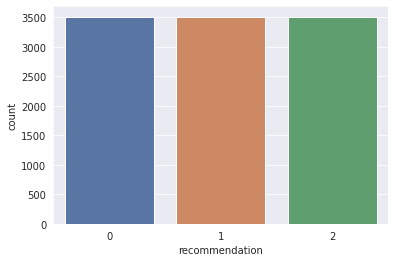

In [ ]:
sns.countplot(x=oversampled['recommendation'])

Ekstraksi fitur menggunakan TfidfVectorizer.
Menghasilkan sebuah vektor dgn weight Tf-Idf.

Menggunakan ngram 2-6, stopwords removal bahasa Inggris, dengan memasukkan hanya apabila document frequency > 0.01 dari total seluruh document.

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

# tfidf_vect = TfidfVectorizer(ngram_range=(2, 6), min_df=0.01)
tfidf_vect = TfidfVectorizer(ngram_range=(2, 6), min_df=0.03)
X_train_tfidf_vect = tfidf_vect.fit_transform(oversampled["review_text"])
X_test_tfidf_vect = tfidf_vect.transform(X_test)
X_train_tfidf_vect.shape, X_test_tfidf_vect.shape

((10527, 923), (1498, 923))

In [ ]:
# print idf values 
df_idf = pd.DataFrame(tfidf_vect.idf_, index=tfidf_vect.get_feature_names_out(),columns=["idf_weights"]) 
# sort ascending 
df_idf.sort_values(by=['idf_weights'], ascending=False).head(100)

,idf_weights
that could,4.502892
the character designs,4.499742
when he,4.499742
read the manga,4.499742
be more,4.499742
...,...
one of those,4.421152
about how,4.421152
not as,4.418249
just to,4.418249


In [ ]:
len(X_train_tfidf_vect.toarray()), len(oversampled)

(10527, 10527)

In [ ]:
def get_bow_features(tfidf_vectorizer, tfidf_fit_value, orig_value):
  dfa = pd.DataFrame(data=tfidf_fit_value.toarray(),columns=tfidf_vectorizer.get_feature_names_out())
  df_concat = pd.concat([orig_value, dfa], axis=1)
  return df_concat

In [ ]:
X_train_df = get_bow_features(tfidf_vect, X_train_tfidf_vect, oversampled["review_text"])
X_test_df = get_bow_features(tfidf_vect, X_test_tfidf_vect, X_test)

In [ ]:
X_train_df.head(10)

,review_text,10 episodes,12 episodes,act like,action scenes,actually good,almost every,along way,already know,also good,...,would probably,would recommend,would say,writing review,year old,years ago,years old,yet another,youre going,youre looking
0,clue waited many years watch show im glad fina...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,rebelpanda best review anything ive ever saw f...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,ive big fan slayers since discovering tv serie...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,well mha back lackluster 5th season welcomes u...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,even third season show still funny ever contin...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,basically sets conflict drive main anime space...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,rewatched local theater recently immersive wor...,0.0,0.0,0.0,0.412494,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,would recommend horimiya comfort story fans re...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.361649,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,animedrew lloyd webber youre idol comedies you...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.441132,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,never like overpowered mc never like clich nev...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.325261,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Training Model

## 1. Support Vector Machine

In [ ]:
X_train_oversampled = oversampled["review_text"]
y_train_oversampled = oversampled["recommendation"]

In [ ]:
from sklearn import svm

svm_model = svm.SVC(C=8.0, kernel='linear')
svm_model.fit(X_train_tfidf_vect, y_train_oversampled)

SVC(C=8.0, kernel='linear')

In [ ]:
svm_model.score(X_test_tfidf_vect, y_test)

0.5433911882510013

In [ ]:
from sklearn.model_selection import cross_val_score

svm_acc = cross_val_score(estimator=svm_model, X=X_train_tfidf_vect, y=y_train_oversampled, cv=5, n_jobs=-1)
svm_acc

array([0.6980057 , 0.69753086, 0.74204276, 0.73396675, 0.72731591])

## 2. Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train_tfidf_vect, y_train_oversampled)
rf_model.score(X_test_tfidf_vect, y_test)

0.6248331108144193

In [ ]:
rf_feat_df = pd.DataFrame(
    rf_model.feature_importances_, 
    columns=['feature importance'], 
    index=tfidf_vect.get_feature_names_out(),
).sort_values('feature importance', ascending=False)

rf_feat_df.head(20)

,feature importance
the only,0.007760
the worst,0.007157
the best,0.006375
of the,0.005687
lot of,0.005658
the story,0.005060
in the,0.004970
at all,0.004899
one of,0.004702
if you,0.004675


In [ ]:
from sklearn.model_selection import cross_val_score

rf_acc = cross_val_score(estimator=rf_model, X=X_train_tfidf_vect, y=y_train_oversampled, cv=5, n_jobs=-1)
rf_acc

array([0.82716049, 0.82668566, 0.88978622, 0.89026128, 0.88598575])

## 3. XGBoost

In [ ]:
import xgboost as xgb

xgb_depth = len(tfidf_vect.get_feature_names_out())

xgb_model = xgb.XGBClassifier(max_depth=xgb_depth)
xgb_model.fit(X_train_tfidf_vect, y_train_oversampled)
xgb_model.score(X_test_tfidf_vect, y_test)

0.5854472630173565

In [ ]:
xgb_feat_df = pd.DataFrame(
    xgb_model.feature_importances_, 
    columns=['feature importance'], 
    index=tfidf_vect.get_feature_names_out(),
).sort_values('feature importance', ascending=False)

xgb_feat_df.head(20)

,feature importance
even worse,0.009010
mixed feelings,0.007389
highly recommend,0.006867
dont recommend,0.006393
isnt even,0.005944
one worst,0.005869
really bad,0.005543
enough time,0.005248
really enjoyed,0.005104
lot time,0.005097


In [ ]:
from sklearn.model_selection import cross_val_score

xgb_acc = cross_val_score(estimator=xgb_model, X=X_train_tfidf_vect, y=y_train_oversampled, cv=5, n_jobs=-1)
xgb_acc

## 4. Decision Tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier

dtc_model = DecisionTreeClassifier(random_state=42)
dtc_model.fit(X_train_tfidf_vect, y_train_oversampled)
dtc_model.score(X_test_tfidf_vect, y_test)

0.507343124165554

In [ ]:
from sklearn.model_selection import cross_val_score

dtc_acc = cross_val_score(estimator=dtc_model, X=X_train_tfidf_vect, y=y_train_oversampled, cv=5, n_jobs=-1)
dtc_acc

array([0.77159037, 0.75696083, 0.7767815 , 0.77101039, 0.78139754])

In [ ]:
dtc_feat_df = pd.DataFrame(
    dtc_model.feature_importances_, 
    columns=['feature importance'], 
    index=tfidf_vect.get_feature_names_out(),
).sort_values('feature importance', ascending=False)

dtc_feat_df.head(20)

,feature importance
waste time,0.019420
feel like,0.016374
dont know,0.012937
one best,0.011502
first episode,0.011066
feels like,0.010323
main characters,0.008835
first season,0.008746
even though,0.008470
mixed feelings,0.008205


## Analisa hasil feature importance yang didapatkan.

In [ ]:
top_features = rf_feat_df.head(20).index.tolist()

In [ ]:
data_filtered = data.copy()
for word in top_features:
  data_filtered[word] = data_filtered["review_text"].apply(lambda x: word in x)
data_filtered.head(3)

,review_text,recommendation,waste time,main character,one best,feel like,character development,art style,feels like,mixed feelings,...,felt like,first episode,even though,even worse,voice acting,main characters,really good,first season,slice life,pretty much
0,ever high hopes netflix adaptations lot shows ...,2,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,shipfu best shipfu hoteru hoteeeel one anime m...,2,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,True,False
2,plot 85 excellent plot problem progression ini...,2,False,False,False,False,False,False,False,False,...,True,False,False,False,True,False,False,False,False,False


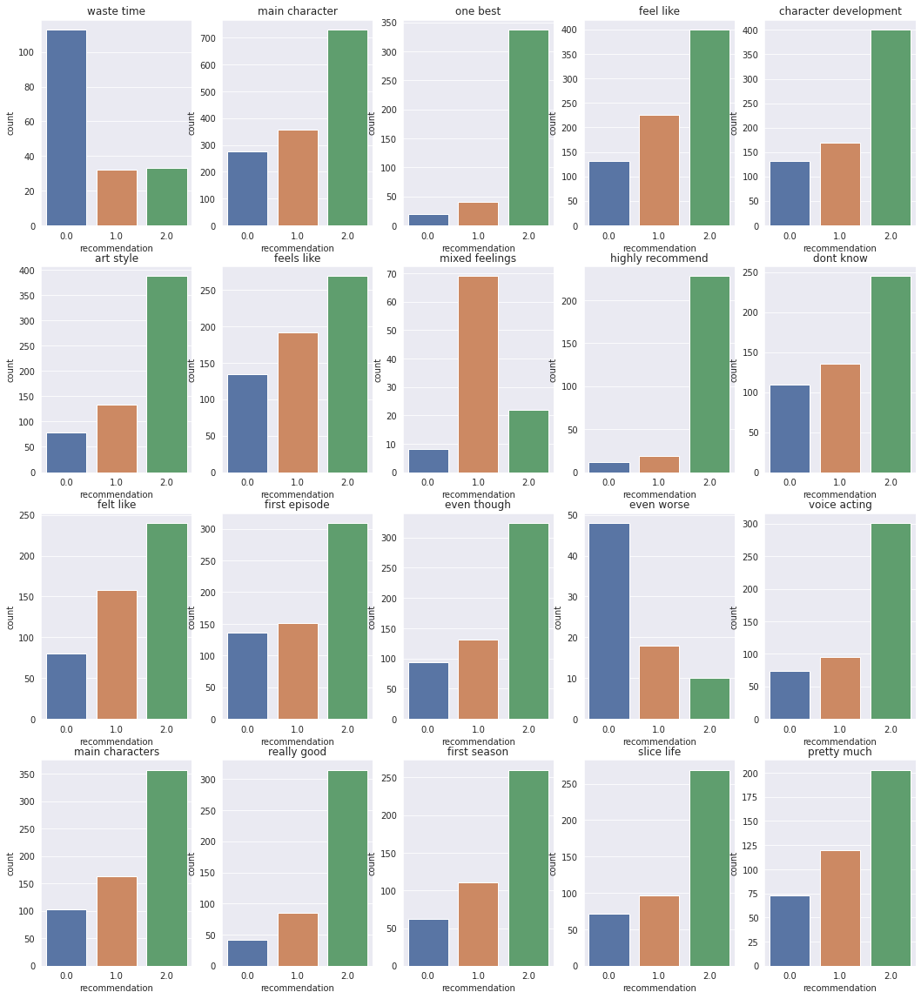

In [ ]:
import matplotlib.pyplot as plt

def getrec(word: str):
  return data_filtered.where(data_filtered[word] == True).dropna().recommendation

def make_countplot(word: str, index):
  x, y = index
  r = getrec(word)
  if len(r) == 0:
    print(word, " has empty recommendation.")
    return
  sns.countplot(x=r, ax=axs[x][y])
  axs[x][y].title.set_text(word)

fig, axs = plt.subplots(ncols=5, nrows=4)
fig.set_figheight(20)
fig.set_figwidth(18)

co = 0
for i in range(0, 4):
  for j in range(0, 5):
    make_countplot(top_features[co], (i, j))
    co += 1

In [ ]:
loopcheck = 0
saverev =[]

for t in orig["review_text"]:
  if "character development" in t:
    if loopcheck < 3:
      # print("found in", t)
      saverev.append(t)
      loopcheck += 1

print(len(saverev))
dftemp = pd.DataFrame(saverev, columns=['review'])
dftemp

3


,review
0,"My shipfu is the best shipfu. 'Not Hoteru, Hot..."
1,"Man, I was really rooting for RWBY: Ice Queend..."
2,Characters: 8/10 Animation: 8/10 Story: 3/10 S...


## Model Evaluation

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix, plot_confusion_matrix

def get_evaluation_metrics(y_pred):
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred, average='macro') 
    # macro calculates metrics for each label
    recall = recall_score(y_test, y_pred, average='macro')
    
    scoring_dict =  {
        'Accuracy' : f'{acc*100:.2f}%',
        'Precision' : f'{prec*100:.2f}%',
        'Recall' : f'{recall*100:.2f}%'
    }
    
    return scoring_dict
    
    
def get_confusion_matrix(model):
    plot_confusion_matrix(model, X_test_tfidf_vect, y_test, normalize='all')

In [ ]:
print("Decision Tree Evaluation: ")
dtc_preds = dtc_model.predict(X_test_tfidf_vect)
get_evaluation_metrics(dtc_preds)

Decision Tree Evaluation: 


{'Accuracy': '80.18%', 'Precision': '80.52%', 'Recall': '79.81%'}

In [ ]:
print("XGBoost Evaluation: ")
xgb_preds = xgb_model.predict(X_test_tfidf_vect)
get_evaluation_metrics(xgb_preds)

XGBoost Evaluation: 


{'Accuracy': '84.26%', 'Precision': '84.11%', 'Recall': '84.00%'}

In [ ]:
print("Random Forest Evaluation: ")
rf_preds = rf_model.predict(X_test_tfidf_vect)
get_evaluation_metrics(rf_preds)

Random Forest Evaluation: 


{'Accuracy': '85.28%', 'Precision': '85.08%', 'Recall': '85.02%'}

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


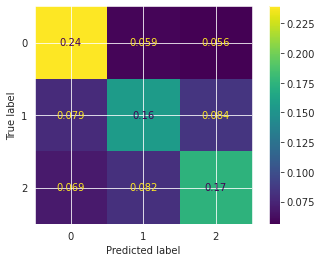

In [ ]:
get_confusion_matrix(svm_model)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


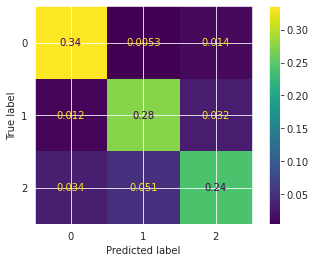

In [ ]:
get_confusion_matrix(rf_model)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


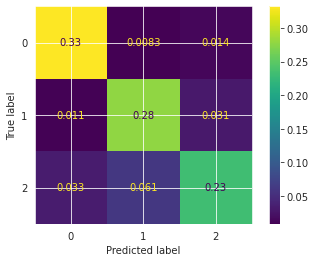

In [ ]:
get_confusion_matrix(xgb_model)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


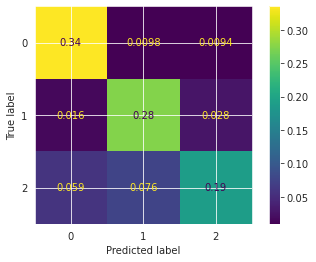

In [ ]:
get_confusion_matrix(dtc_model)

# Trying Hyperparameter Tuning with RandomizedSearchCV

In [ ]:
from sklearn.linear_model import LogisticRegression

lr_model = LogisticRegression(random_state=42, max_iter=500)
lr_model.fit(X_tf_vect, y_train_oversampled)
lr_model.score(X_test_tfidrain_tfidf_vect, y_test)

0.5173564753004005

In [ ]:
from sklearn.neural_network import MLPClassifier

mlp_model = MLPClassifier(random_state=42, activation="logistic", learning_rate="adaptive", max_iter=500)
mlp_model.fit(X_train_tfidf_vect, y_train_oversampled)
mlp_model.score(X_test_tfidf_vect, y_test)

0.5080106809078772

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

grid = {
    "n_estimators" : [10, 100, 200, 500],
    "max_depth" : [None, 5, 10, 20, 30],
    "min_samples_split" : [2, 4, 6],
    "min_samples_leaf" : [1, 2, 4]
}

new_rf_model = RandomizedSearchCV(estimator=rf_model,
                                  param_distributions=grid,
                                  n_iter=10,
                                  cv=5,
                                  verbose=2)

new_rf_model.fit(X_train_tfidf_vect, y_train_oversampled)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END max_depth=20, min_samples_leaf=4, min_samples_split=2, n_estimators=100; total time=   1.3s
[CV] END max_depth=20, min_samples_leaf=4, min_samples_split=2, n_estimators=100; total time=   0.8s
[CV] END max_depth=20, min_samples_leaf=4, min_samples_split=2, n_estimators=100; total time=   1.0s
[CV] END max_depth=20, min_samples_leaf=4, min_samples_split=2, n_estimators=100; total time=   1.0s
[CV] END max_depth=20, min_samples_leaf=4, min_samples_split=2, n_estimators=100; total time=   1.0s
[CV] END max_depth=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500; total time=   1.9s
[CV] END max_depth=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500; total time=   1.6s
[CV] END max_depth=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500; total time=   1.6s
[CV] END max_depth=5, min_samples_leaf=1, min_samples_split=6, n_estimators=500; total time=   1.6s
[CV] END max_depth=5, min_samples_

RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
                   param_distributions={'max_depth': [None, 5, 10, 20, 30],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 4, 6],
                                        'n_estimators': [10, 100, 200, 500]},
                   verbose=2)

In [ ]:
new_rf_model.best_params_

{'n_estimators': 500,
 'min_samples_split': 4,
 'min_samples_leaf': 2,
 'max_depth': None}

In [ ]:
new_rf_model.score(X_test_tfidf_vect, y_test)

0.595460614152203

In [ ]:
print("Tuned RF Evaluation: ")
new_rf_preds = new_rf_model.predict(X_test_tfidf_vect)
get_evaluation_metrics(new_rf_preds)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


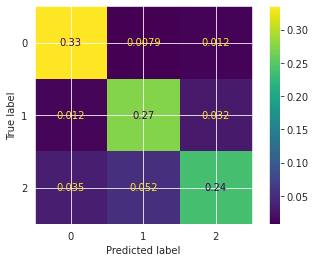

In [ ]:
get_confusion_matrix(new_rf_model)

# Text Network Analysis

In [ ]:
vocab_keys = tfidf_vect.vocabulary_.keys()

In [ ]:
words_in = pd.DataFrame()

rec_dict = {}
mixed_dict = {}
not_rec_dict = {}

for i, row in data.iterrows():
    words = []
    for j in vocab_keys:
        if j in row['review_text']:
            words.append(j)
            
            # Take note of where certain words appear in the dataset is it in a recommendation, mixed, or not recommended
            if row['recommendation'] == 0:
                vocab_dict = not_rec_dict
            elif row['recommendation'] == 1:
                vocab_dict = mixed_dict
            elif row['recommendation'] == 2:
                vocab_dict = rec_dict
                
            if j not in vocab_dict:
                vocab_dict[j] = 1
            else:
                vocab_dict[j] += 1
                
    index = i
    word = vocab_keys
    df = pd.DataFrame([
        {
            'Idx' : index,
            'Words' : words,
        }
    ])
    
    # Dataframe of index and the words in them    
    words_in = pd.concat([words_in, df])

In [ ]:
rec_dict

In [ ]:
words_in.head(10)

In [ ]:
# For every word in the class dictionary, count which other word appears together with it and how many times (set to zero for everything first)
rec_conn_ctr = {}

for i in rec_dict:
    rec_conn_ctr[i] = dict()
    for j in rec_dict:
        if j != i:
            rec_conn_ctr[i][j] = 0
            
rec_conn_ctr

In [ ]:
mixed_conn_ctr = {}

for i in mixed_dict:
    mixed_conn_ctr[i] = dict()
    for j in mixed_dict:
        if j != i:
            mixed_conn_ctr[i][j] = 0

In [ ]:
not_rec_conn_ctr = {}

for i in not_rec_dict:
    not_rec_conn_ctr[i] = dict()
    for j in not_rec_dict:
        if j != i:
            not_rec_conn_ctr[i][j] = 0

In [ ]:
for i, row in words_in.iterrows():
    conn_words = row['Words']
    
    # Add up the connection count between words
    for j in rec_dict:
        if j in conn_words:
            for wrd in conn_words:
                if wrd in rec_conn_ctr[j]:
                    rec_conn_ctr[j][wrd] += 1
            
    for j in mixed_dict:
        if j in conn_words:
            for wrd in conn_words:
                if wrd in mixed_conn_ctr[j]:
                    mixed_conn_ctr[j][wrd] += 1
    
    for j in not_rec_dict:
        if j in conn_words:
            for wrd in conn_words:
                if wrd in not_rec_conn_ctr[j]:
                    not_rec_conn_ctr[j][wrd] += 1

In [ ]:
rec_conn_ctr

{'feel like': {'worth watching': 23,
  'doesnt feel': 82,
  'doesnt feel like': 68,
  'well written': 32,
  'also really': 28,
  'worth watch': 39,
  'like story': 25,
  'character development': 103,
  'little bit': 36,
  'recommend anyone': 12,
  'nothing special': 23,
  'slice life': 52,
  'screen time': 25,
  'one anime': 22,
  'voice acting': 65,
  'felt like': 116,
  'theres much': 28,
  'good enough': 19,
  'like characters': 43,
  'really good': 71,
  'watching anime': 28,
  'would recommend': 24,
  'even though': 91,
  'sound effects': 12,
  'bad thing': 27,
  'animation art': 13,
  'anime series': 16,
  'thats really': 15,
  'dont know': 61,
  'recommend anime': 10,
  'anime good': 15,
  'main protagonist': 12,
  'character design': 99,
  'ive seen': 49,
  'years old': 4,
  'pretty much': 69,
  'story pretty': 15,
  'id say': 34,
  'side characters': 86,
  'main cast': 30,
  'makes show': 13,
  'youre looking': 24,
  'make sense': 33,
  'looks like': 21,
  'doesnt matter': 6,


In [ ]:
mixed_conn_ctr

{'main character': {'one two': 36,
  'main characters': 623,
  'really like': 73,
  'two main': 97,
  'two main characters': 79,
  'like first': 23,
  'couple episodes': 28,
  'actually good': 18,
  'nothing special': 34,
  'slice life': 97,
  'high school': 82,
  'anime watch': 41,
  'fight scenes': 68,
  'theres lot': 30,
  'feel like': 161,
  'doesnt feel': 34,
  'doesnt feel like': 12,
  'art style': 118,
  'everyone else': 40,
  'op ed': 39,
  'get better': 21,
  'video game': 34,
  'doesnt work': 15,
  'doesnt make': 29,
  'make sense': 43,
  'pretty decent': 25,
  'like anime': 65,
  'characters dont': 45,
  'something like': 43,
  'dont care': 19,
  'go watch': 24,
  'pretty good': 88,
  'one character': 63,
  'like show': 50,
  'one characters': 36,
  'show one': 34,
  'one would': 36,
  'characters anime': 36,
  'feels like': 161,
  'really much': 14,
  'would say': 63,
  'watch movie': 39,
  'good enough': 32,
  'looks like': 48,
  'sound design': 31,
  'really hard': 20,
  

In [ ]:
not_rec_conn_ctr

{'thing anime': {'feels like': 16,
  'best part': 4,
  'takes place': 4,
  'really good': 10,
  'character development': 26,
  'show really': 0,
  'feel like': 14,
  'story characters': 12,
  'ive seen': 8,
  'much better': 3,
  'dont see': 3,
  'im sure': 10,
  'didnt really': 3,
  'doesnt feel': 3,
  'doesnt feel like': 2,
  'throughout series': 1,
  'action sequences': 2,
  'theres much': 4,
  'dont really': 13,
  'many characters': 1,
  'one character': 5,
  'even though': 14,
  'show characters': 0,
  'doesnt really': 1,
  'one characters': 3,
  'anime anime': 13,
  'good job': 3,
  'even better': 2,
  'seems like': 4,
  'good thing': 20,
  'story character': 17,
  'go back': 3,
  'id say': 1,
  'really anything': 2,
  'story good': 2,
  'three episodes': 1,
  'show much': 3,
  'really care': 1,
  'even worse': 3,
  'dont like': 10,
  'im going': 5,
  'next episode': 4,
  'cant say': 6,
  'show one': 3,
  'doesnt work': 3,
  'gon na': 10,
  'show isnt': 5,
  'dont know': 12,
  'ch

In [ ]:
import networkx as nx
import plotly.offline as py
import plotly.graph_objects as go

In [ ]:
def create_text_network_graph(data_dict_ctr, data_dict_conn_ctr, word_limit, conn_limit):
    g = nx.Graph()
    added = []
    
    for char in data_dict_ctr.keys():
        if data_dict_ctr[char] > word_limit:
            added.append(char)
            g.add_node(char, size=0.8*data_dict_ctr[char])
            
    for char in added:
        for co_char in data_dict_conn_ctr[char].keys():
            if data_dict_conn_ctr[char][co_char] > conn_limit:
                if co_char in added:
                    g.add_edge(char, co_char, weight=0.1*data_dict_conn_ctr[char][co_char])
                    
    pos_ = nx.spring_layout(g)
    
    def make_edge(x, y, text, width):
        return go.Scatter(x=x,
               y=y,
               line=dict(width=width,
                         color='cornflowerblue'),
               hoverinfo='text',
               text=([text]),
               mode='lines'
               )
    
    edge_trace = []

    for edge in g.edges():
        if g.edges()[edge]['weight'] > 0:
            char_1 = edge[0]
            char_2 = edge[1]
            
            x0, y0 = pos_[char_1]
            x1, y1 = pos_[char_2]
                    
            text = char_1 + '--' + char_2 + ': ' + str(g.edges()[edge]['weight'])
            trace  = make_edge([x0, x1, None], [y0, y1, None], text, 
                            width = 0.1*g.edges()[edge]['weight'])
            edge_trace.append(trace)
            
    node_trace = go.Scatter(x=[],
                        y=[],
                        text=[],
                        textposition="top center",
                        textfont_size=10,
                        mode='markers+text',
                        hoverinfo='none',
                        marker=dict(color=[],
                                    size=[],
                                    line=None))

    for node in g.nodes():
        x, y = pos_[node]
        node_trace['x'] += tuple([x])
        node_trace['y'] += tuple([y])
        node_trace['marker']['color'] += tuple(['cornflowerblue'])
        try:
            node_trace['marker']['size'] += tuple([0.1*g.nodes()[node]['size']])   
        except KeyError:
            pass
        node_trace['text'] += tuple(['<b>' + node + '</b>'])
        
    layout = go.Layout(
        paper_bgcolor='rgba(255,255,255,255)', # transparent background
        plot_bgcolor='rgba(255,255,255,255)', # transparent 2nd background
        xaxis={'showgrid': False, 'zeroline': False}, # no gridlines
        yaxis={'showgrid': False, 'zeroline': False}, # no gridlines
    )
    # Create figure
    fig = go.Figure(layout=layout)
    # Add all edge traces
    for trace in edge_trace:
        fig.add_trace(trace)
    # Add node trace
    fig.add_trace(node_trace)
    # Remove legend
    fig.update_layout(showlegend=False,
                    margin=dict(
                        l=0,
                        r=0,
                        b=0,
                        t=0,
                        pad=4
                    ))
    # Remove tick labels
    fig.update_xaxes(showticklabels=False)
    fig.update_yaxes(showticklabels=False)
    # Show figure
    fig.show()

In [ ]:
create_text_network_graph(rec_dict, rec_conn_ctr, 100, 20)

In [ ]:
create_text_network_graph(mixed_dict, mixed_conn_ctr, 70, 20)

In [ ]:
create_text_network_graph(not_rec_dict, not_rec_conn_ctr, 30, 10)

# Saving Model

In [ ]:
import pickle

def save_model(name, model):
  filename = 'drive/My Drive/ML/' + name + '.model'
  pickle.dump(model, open(filename, 'wb'))

def load_model(filename):
  filename = f"drive/My Drive/ML/{filename}.model"
  return pickle.load(open(filename, "rb"))

In [ ]:
for m in [(svm_model, "svm"), (rf_model, "random_forest"), (xgb_model, "xgboost"), (dtc_model, "decision_tree")]:
  save_model(m[1], m[0])

In [ ]:
loaded_rf_model = load_model("random_forest")
loaded_rf_model.score(X_test_tfidf_vect, y_test)

0.8527746319365799

0.8527746319365799